In [1]:
import numba as nb
import numpy as np
import matplotlib.pyplot as plt

In [2]:
from poison2dsolver import PS2DFunctionalMinimization

PS = PS2DFunctionalMinimization()

---
### Task 3: Functional Minimization (15 points)

The goal of this task is to solve the 2D Poisson equation by **direct minimization of the functional $S$**.

#### Problem Statement:
The Poisson equation in 2D is given by:  
$\nabla^2 u = -\rho(x, y)$  

Instead of using relaxation methods, we minimize the **Lagrangian functional $S$** directly:  
$S = - \int_P \left[ \frac{1}{2} \left( u \frac{\partial^2 u}{\partial x^2} \right) + \frac{1}{2} \left( u \frac{\partial^2 u}{\partial y^2} \right) + \rho(i, j) \cdot u(i, j) \right] \, dx\, dy$  

#### Method:
1. **Local Minimization:**  
   - For each point $(i, j)$, calculate the **local functional $S(\delta)$** for shifts $\delta = [0, 0.5, 1]$.  
   - Use **parabolic interpolation** to find the optimal shift $\delta_4$:  
     $\delta_4 = \frac{1}{4} \cdot \frac{3S_1 - 4S_2 + S_3}{S_1 - 2S_2 + S_3}$  
   - Calculate the corresponding value $S_4$ and determine the minimum among $[S_1, S_2, S_3, S_4]$.  
   - Update the potential $u(i, j)$ using the optimal shift $\delta$.  

2. **Iterative Update:**  
   - Repeat the update for **all grid points**, excluding boundaries.  
   - Perform the update **point by point** to gradually minimize the functional $S$.  

#### Objective:
- Plot $S$ as a function of the number of iterations.  
- Compare the convergence speed with tasks 1 and 2.  
- Use the same initial condition as in previous tasks.  

In [3]:
iterations = 50
s_array = np.zeros(iterations)

for i in range(iterations):
    #one iteration on the u grid
    PS.update()
    #get the S value
    s_array[i] = PS.s_conv()

0 0.5 1
S1 0.0
S2 -0.7023681071757083
S3 -2.809472428702833
0 0.5 1
S1 0.0
S2 -0.5912028934727175
S3 -2.36481157389087
0 0.5 1
S1 0.0
S2 -0.44352246405112683
S3 -1.7740898562045073
0 0.5 1
S1 0.0
S2 -0.2964477667302149
S3 -1.1857910669208596
0 0.5 1
S1 0.0
S2 -0.17645417948983982
S3 -0.7058167179593593
0 0.5 1
S1 0.0
S2 -0.09348182851361574
S3 -0.37392731405446294
0 0.5 1
S1 0.0
S2 -0.04405229859594368
S3 -0.17620919438377472
0 0.5 1
S1 0.0
S2 -0.01845340625166306
S3 -0.07381362500665224
0 0.5 1
S1 0.0
S2 -0.006867009491423348
S3 -0.02746803796569339
0 0.5 1
S1 0.0
S2 -0.0022686266412751156
S3 -0.009074506565100462
0 0.5 1
S1 0.0
S2 -0.0006649591668194024
S3 -0.0026598366672776095
0 0.5 1
S1 0.0
S2 -0.00017282699293347397
S3 -0.0006913079717338959
0 0.5 1
S1 0.0
S2 -3.980884473164044e-05
S3 -0.00015923537892656176
0 0.5 1
S1 0.0
S2 -8.122428105264219e-06
S3 -3.2489712421056874e-05
0 0.5 1
S1 0.0
S2 -1.4673639721220747e-06
S3 -5.869455888488299e-06
0 0.5 1
S1 0.0
S2 -2.3461883694043403e

0 0.5 1
S1 0.0
S2 -4.646397967592138e-40
S3 -1.858559187036855e-39
0 0.5 1
S1 0.0
S2 -4.2745261999204885e-42
S3 -1.7098104799681954e-41
0 0.5 1
S1 0.0
S2 -3.470792473555809e-44
S3 -1.3883169894223237e-43
0 0.5 1
S1 0.0
S2 -2.4873205607479954e-46
S3 -9.949282242991982e-46
0 0.5 1
S1 0.0
S2 -1.573227323357196e-48
S3 -6.292909293428784e-48
0 0.5 1
S1 0.0
S2 -8.782186700075472e-51
S3 -3.512874680030189e-50
0 0.5 1
S1 0.0
S2 -4.326739863177834e-53
S3 -1.7306959452711334e-52
0 0.5 1
S1 0.0
S2 -1.8813164285717277e-55
S3 -7.525265714286911e-55
0 0.5 1
S1 0.0
S2 -7.219420506548015e-58
S3 -2.887768202619206e-57
0 0.5 1
S1 0.0
S2 -2.4450016608585e-60
S3 -9.780006643434e-60
0 0.5 1
S1 0.0
S2 -7.307849186267671e-63
S3 -2.9231396745070686e-62
0 0.5 1
S1 0.0
S2 -1.9276633227148884e-65
S3 -7.710653290859554e-65
0 0.5 1
S1 0.0
S2 -4.487473119579555e-68
S3 -1.794989247831822e-67
0 0.5 1
S1 0.0
S2 -9.219337893598236e-71
S3 -3.6877351574392945e-70
0 0.5 1
S1 0.0
S2 -1.6715645441310346e-73
S3 -6.6862581765

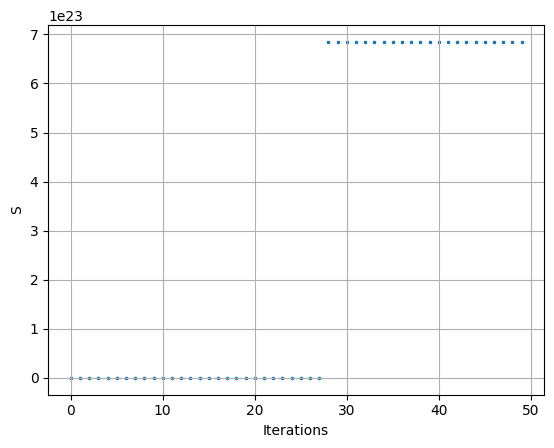

In [4]:
plt.scatter(np.arange(0,iterations), s_array, s=3, marker='x')
plt.xlabel('Iterations')
plt.ylabel('S')
plt.grid()
plt.show()

In [1]:
import numpy as np
import matplotlib.pyplot as plt

# Parametry
N = 31
dx = 1
x0 = 4
d = 4
max_iter = 500

# Przygotowanie siatki
grid_size = 2 * N + 1
u = np.zeros((grid_size, grid_size))
i_indices = np.arange(-N, N + 1)
j_indices = np.arange(-N, N + 1)

# Obliczanie gęstości ładunku rho
rho = np.zeros((grid_size, grid_size))
for i in range(grid_size):
    for j in range(grid_size):
        x = i_indices[i]
        y = j_indices[j]
        term1 = np.exp(-((x - x0)**2 + y**2) / d**2)
        term2 = np.exp(-((x + x0)**2 + y**2) / d**2)
        rho[i, j] = term1 - term2

# Funkcja obliczająca lokalny wkład do S
def compute_S_loc(u, i, j, rho, N):
    S_loc = 0.0
    for di in [-1, 0, 1]:
        for dj in [-1, 0, 1]:
            ii = i + di
            jj = j + dj
            if ii < -N or ii > N or jj < -N or jj > N:
                u_val = 0.0
                rho_val = 0.0
            else:
                arr_i = ii + N
                arr_j = jj + N
                u_val = u[arr_i, arr_j]
                rho_val = rho[arr_i, arr_j]
            
            # Laplacian w kierunku x
            if ii + 1 > N:
                u_x_plus = 0.0
            else:
                u_x_plus = u[arr_i + 1, arr_j] if (ii + 1) <= N else 0.0
            if ii - 1 < -N:
                u_x_minus = 0.0
            else:
                u_x_minus = u[arr_i - 1, arr_j] if (ii - 1) >= -N else 0.0
            laplacian_x = u_x_plus + u_x_minus - 2 * u_val
            
            # Laplacian w kierunku y
            if jj + 1 > N:
                u_y_plus = 0.0
            else:
                u_y_plus = u[arr_i, arr_j + 1] if (jj + 1) <= N else 0.0
            if jj - 1 < -N:
                u_y_minus = 0.0
            else:
                u_y_minus = u[arr_i, arr_j - 1] if (jj - 1) >= -N else 0.0
            laplacian_y = u_y_plus + u_y_minus - 2 * u_val
            
            term1 = 0.5 * u_val * laplacian_x
            term2 = 0.5 * u_val * laplacian_y
            term3 = rho_val * u_val
            S_loc += term1 + term2 + term3
    
    return -S_loc  # dx=1, więc dx²=1

# Śledzenie wartości S
S_history = []

# Inicjalizacja S
S_total = 0.0
for i in range(1, grid_size - 1):
    for j in range(1, grid_size - 1):
        grid_i = i_indices[i]
        grid_j = j_indices[j]
        S_total += compute_S_loc(u, grid_i, grid_j, rho, N)
S_history.append(S_total)

# Główna pętla iteracyjna
for iter in range(max_iter):
    for i in range(1, grid_size - 1):
        for j in range(1, grid_size - 1):
            grid_i = i_indices[i]
            grid_j = j_indices[j]
            u_old = u[i, j]
            
            # Oblicz S_loc dla starego u
            S_loc_old = compute_S_loc(u, grid_i, grid_j, rho, N)
            
            # Testuj delty 0, 0.5, 1
            deltas = [0.0, 0.5, 1.0]
            S_values = []
            for delta in deltas:
                u[i, j] = u_old + delta
                S_loc_new = compute_S_loc(u, grid_i, grid_j, rho, N)
                S_candidate = S_total - S_loc_old + S_loc_new
                S_values.append(S_candidate)
                u[i, j] = u_old  # Cofnij zmianę
            
            # Oblicz delta4
            S1, S2, S3 = S_values
            denominator = S1 - 2*S2 + S3
            if denominator == 0:
                delta4 = 0.0
            else:
                delta4 = (3*S1 - 4*S2 + S3) / (4 * denominator)
            
            # Oblicz S4 dla delta4
            u[i, j] = u_old + delta4
            S_loc_new4 = compute_S_loc(u, grid_i, grid_j, rho, N)
            S4_candidate = S_total - S_loc_old + S_loc_new4
            S_values.append(S4_candidate)
            u[i, j] = u_old  # Cofnij zmianę
            
            # Wybierz najlepszą deltę
            min_idx = np.argmin(S_values)
            best_delta = [0.0, 0.5, 1.0, delta4][min_idx]
            
            # Zastosuj najlepszą deltę i aktualizuj S_total
            u[i, j] = u_old + best_delta
            S_total = S_values[min_idx]
    
    S_history.append(S_total)
    
    if iter % 50 == 0:
        print(f"Iteracja {iter:4d}, S = {S_total:.4e}")

# Wykres
plt.plot(S_history)
plt.xlabel('Iteracja')
plt.ylabel('Wartość S')
plt.title('Zbieżność funkcjonału S w Zadaniu 3')
plt.grid(True)
plt.show()

Iteracja    0, S = -1.9490e+01
Iteracja   50, S = -2.1506e+02
Iteracja  100, S = -2.3791e+02


KeyboardInterrupt: 